<h1 align='center'>
<br>
    <img src="./assets/ibm_x_taiwan.png" alt="IBM Course" width="400">
<br>
    Applied Data Science Capstone
</h1>


<h2 align='center'>
The Battle of Neighborhoods - A Look Around Universities in Taiwan
</h2>

<h5 align='center'>
    Brian L. Chen, Feb., 2021
</h5>


## 1. Introduction

### 1.1 Background
Taiwan is known for its outstanding performance throughout this pandemic, and students from all over the world urge to know more about the unique island. Taiwan strictly performs its regulation and carries out a 14-day quarantine for people who are allowed to enter the island, including Taiwanese citizens. 

Besides the restrictions, Taiwan is also known for its high population density (ranked 17th worldwide in 2019 according to [statista](https://www.statista.com/statistics/264683/top-fifty-countries-with-the-highest-population-density/)), beautiful mountains, and convenience. 

As a student currently studying in Taiwan, providing an insightful analysis to the local universities in terms of convenience would be interesting for future students when it comes to choosing which university to go to. Though it may be somewhat absurd only choosing universities based on their convenience, it is still something worth noticing, especially for those who haven't actually been to a specific university before. 

Moreover, as a gym-goer and a sports fanatic, picking an university surrounded by sports facilities is always considerable. 

### 1.2 Interest 

The project is then aiming (1) **to examine the neighborhood of each university in Taiwan, exploring how it is like to live around its neighborhood**, and (2) **to inspect the sports facilities around each university in Taiwan**. 

The aim is to help future students choose their universities in terms on what their neighborhoods have to offer and what they would like to experience. The second part of this project could also help students playing sports gain a better perspective on which school to go to based on their preferences. 


<div class='alert alert-block alert-warning' style='margin-top: 20px'>
🗒️ Notice<br>
I am not here to get involved in any political issues. Taiwan is a beautiful place with beautiful people, and the project aims to provide insights regarding the universities on the island. Please do not add extra political perspective towards this project.
</div>

![](https://dynaimage.cdn.cnn.com/cnn/q_auto,w_900,c_fill,g_auto,h_506,ar_16:9/http%3A%2F%2Fcdn.cnn.com%2Fcnnnext%2Fdam%2Fassets%2F180719131350-beautiful-taiwan-popumon-alishan.jpg)

## 2. Data Acquisition and Cleaning

### 2.1 Data Sources
#### 2.1.1 List of Accredited Taiwan Universities
The data of listed universities is from the Ministry of Education, which can be found [here](https://ulist.moe.gov.tw/Download/FileDownload). The data contains the following information:

+ School ID
+ Private/Public Status
+ System/Institution
+ University Name (in Chinese)
+ University Name (in English)
+ Principal of the university
+ County
+ School District
+ Postal Code
+ School Address (in Chinese)
+ Tel
+ School Website

Since longitude and latitude for each school is not listed, **[HERE API](https://developer.here.com)** is used to fetch the data needed to be further processed using Foursquare. The final outcome is *stored locally* so that the API calls will not be provoked everytime when I restart the kernal.

The final attributes include:

+ Serial Number 
+ ID
+ Public/Private
+ System
+ Name
+ Eng. Name
+ Postal Code
+ Latitude
+ Longitude
+ Address
+ City
+ County
+ Neighborhood
+ County (zh)

#### 2.1.2 Geojson Data of Taiwan
The **geojson data** of Taiwan is obtained to plot the choropleth map. The data helps define the boundaries for each county in Taiwan. It is provided by **[g0v](https://github.com/g0v/twgeojson)**. Since the data hasn't been updated for nearly 6 years, some content from the dataset needs to be corrected.

I'm fetching [this](https://raw.githubusercontent.com/g0v/twgeojson/master/json/twCounty2010.geo.json) particular geojson data. As an example of the correction, 桃園縣 (Taoyuan County) needs to be corrected to 桃園市 (Taoyuan City). 
  
#### 2.1.3 Information of Venues Around Universities
[Foursquare API](https://developer.foursquare.com) is used to obtain the final list of venues to be further examined. Also note that Foursquare API uses special "category id" for each category. Since I am collecting a series of fitness/gym sites, scraping (instead of connecting through [its API](https://developer.foursquare.com/docs/api-reference/venues/categories/) the [venue category page](https://developer.foursquare.com/docs/build-with-foursquare/categories/) works better for me. I am collecting data with the following information:

+ University (zh)
+ University (eng)
+ University Latitude
+ University Longitude
+ Venue
+ Venue Latitude
+ Venue Longitude
+ Venue Category

#### 2.1.4 Results
Last but not least, there would be a total of **five** datasets to make analysis from: 

1. Venues within 1,500m for each university on the list - to examine the convenience of each university
2. Sports venues within 1,000m and 2,000m
3. Gym venues only within 1,0000m and 2,000m

### 2.2 Data Processing

Please visit the `Data Processing` notebook for fully detailed data processing steps. Here, I will just retrieve from what I've already done for convenience. 

In [1]:
# Import libraries

import pandas as pd
import numpy as np
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values
import requests
import json
import geocoder
import geopandas as gpd
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
from tqdm.notebook import tqdm
from tqdm.contrib import tzip
import math
import mgt2001

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt # plotting library
%matplotlib inline 

# import k-means from clustering stage
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster.elbow import kelbow_visualizer


import folium # map rendering library
from folium import plugins

# scraping libraries
from bs4 import BeautifulSoup

plt.style.use('ggplot') # refined style

In [2]:
df = pd.read_csv('assets/data/p_ulist_2021-02-20.csv')
udf = df.copy()
udf.head()

,Serial Number,ID,Public/Private,System,Name,Eng. Name,Postal Code,Latitude,Longitude,Address,City,County,Neighborhood,County (zh)
0,1,0001,Public,一般大學,國立政治大學,National Chengchi Universerity,11605,24.98741,121.57651,"No. 64, Sec 2, Zhi Nan Rd., Wenshan District, ...",Taipei City,Taipei City,Wenshan District,臺北市
1,2,0002,Public,一般大學,國立清華大學,National Tsing Hua University,30013,24.79635,120.99686,"No. 101, Sec 2, Guang Fu Rd., East District, H...",Hsinchu City,Hsinchu City,East District,新竹市
2,3,0003,Public,一般大學,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,10617,25.01697,121.53369,"No. 1, Sec 4, Luo Si Fu Rd., Daan District, Ta...",Taipei City,Taipei City,Daan District,臺北市
3,4,0004,Public,一般大學,國立臺灣師範大學,National Taiwan Normal University,10610,25.02643,121.52756,"No. 162, Sec 1, He Ping E. Rd., Daan District,...",Taipei City,Taipei City,Daan District,臺北市
4,5,0005,Public,一般大學,國立成功大學,National Cheng Kung University,70101,22.99632,120.21953,"No. 1, Da Syue Rd., East District, Tainan City...",Tainan City,Tainan City,East District,臺南市


In [3]:
uni_venues = pd.read_csv('assets/data/uni_venues_1500_2021-02-20.csv')
uni_sports_venues = pd.read_csv('assets/data/uni_sports_venues_2021-02-20.csv')
uni_sports_venues_2000 = pd.read_csv('assets/data/uni_sports_venues_2000_2021-02-20.csv')
uni_gym_venues = pd.read_csv('assets/data/uni_gym_venues_2021-02-20.csv')
uni_gym_venues_2000 = pd.read_csv('assets/data/uni_gym_venues_2000_2021-02-20.csv')
print('Uni Venues (1,500 m):')
display(uni_venues.head())
print('Uni Sports Venues (1,000 m):')
display(uni_sports_venues.head())
print('Uni Sports Venues (2,000 m):')
display(uni_sports_venues_2000.head())
print('Uni Gym Venues (1,000 m):')
display(uni_gym_venues.head())
print('Uni Gym Venues (2,000 m):')
display(uni_gym_venues_2000.head())

Uni Venues (1,500 m):


,University (zh),University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,國立政治大學,National Chengchi Universerity,24.98741,121.57651,滇味廚房,24.987366,121.577474,Chinese Restaurant
1,國立政治大學,National Chengchi Universerity,24.98741,121.57651,道南館,24.988596,121.573602,Coffee Shop
2,國立政治大學,National Chengchi Universerity,24.98741,121.57651,JASONS Market Place,24.988345,121.576373,Supermarket
3,國立政治大學,National Chengchi Universerity,24.98741,121.57651,咖啡大亨磨坊 DICTY CAFÉ,24.987489,121.576419,Café
4,國立政治大學,National Chengchi Universerity,24.98741,121.57651,Starbucks (星巴克),24.987716,121.575899,Coffee Shop


Uni Sports Venues (1,000 m):


,University (zh),University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,國立政治大學,National Chengchi Universerity,24.98741,121.57651,Roman Square (羅馬廣場),24.986799,121.574540,Plaza
1,國立政治大學,National Chengchi Universerity,24.98741,121.57651,道南右岸河濱公園,24.995167,121.572406,Park
2,國立政治大學,National Chengchi Universerity,24.98741,121.57651,政大堤外球場,24.984681,121.572953,Baseball Field
3,國立政治大學,National Chengchi Universerity,24.98741,121.57651,政大網球場(山上) Tennis Courts,24.981970,121.578353,College Tennis Court
4,國立清華大學,National Tsing Hua University,24.79635,120.99686,清華大學新體育館 NTHU Stadium,24.793868,120.992318,College Stadium


Uni Sports Venues (2,000 m):


,University (zh),University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,國立政治大學,National Chengchi Universerity,24.98741,121.57651,臺北市文山運動中心 Taipei Wenshan Sports Center,24.996909,121.559737,Gym
1,國立政治大學,National Chengchi Universerity,24.98741,121.57651,Roman Square (羅馬廣場),24.986799,121.574540,Plaza
2,國立政治大學,National Chengchi Universerity,24.98741,121.57651,道南右岸河濱公園,24.995167,121.572406,Park
3,國立政治大學,National Chengchi Universerity,24.98741,121.57651,萬芳公園 Wanfang Park,25.000369,121.567780,Park
4,國立政治大學,National Chengchi Universerity,24.98741,121.57651,政大堤外球場,24.984681,121.572953,Baseball Field


Uni Gym Venues (1,000 m):


,University (zh),University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,國立清華大學,National Tsing Hua University,24.79635,120.99686,清華大學新體育館 NTHU Stadium,24.793868,120.992318,College Stadium
1,國立清華大學,National Tsing Hua University,24.79635,120.99686,NCTU Gym,24.789599,120.995678,College Gym
2,國立清華大學,National Tsing Hua University,24.79635,120.99686,NCTU Swimming Pool,24.789435,120.995600,Gym Pool
3,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,25.01697,121.53369,World Gym,25.014470,121.534600,Gym / Fitness Center
4,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,25.01697,121.53369,台灣大學舊體育館,25.019733,121.535821,College Gym


Uni Gym Venues (2,000 m):


,University (zh),University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,國立政治大學,National Chengchi Universerity,24.98741,121.57651,臺北市文山運動中心 Taipei Wenshan Sports Center,24.996909,121.559737,Gym
1,國立清華大學,National Tsing Hua University,24.79635,120.99686,清華大學新體育館 NTHU Stadium,24.793868,120.992318,College Stadium
2,國立清華大學,National Tsing Hua University,24.79635,120.99686,NCTU Gym,24.789599,120.995678,College Gym
3,國立清華大學,National Tsing Hua University,24.79635,120.99686,NCTU Swimming Pool,24.789435,120.995600,Gym Pool
4,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,25.01697,121.53369,Taipei DaAn Sports Center (臺北市大安運動中心),25.020867,121.545980,Gym / Fitness Center


## 3. Methodology
### 3.1 Exploratory Data Analysis

We will first look at the number of universities in each county/city. To help achieve the goal, we will have to get the English and Chinese reference for each county. We will download a table storing the data from [this site](https://www.thinkclub.com.tw/台灣縣市英文及英文縮寫/).

In [4]:
abbr_df = pd.read_html('https://www.thinkclub.com.tw/%e5%8f%b0%e7%81%a3%e7%b8%a3%e5%b8%82%e8%8b%b1%e6%96%87%e5%8f%8a%e8%8b%b1%e6%96%87%e7%b8%ae%e5%af%ab/')[0]
abbr_df.head()

,0,1,2,3,4,5,6
0,縣/市,分類,英文(通用拼英),英文(漢語拼音),代碼(ISO 3166/MA),城市代碼,英文縮寫
1,基隆市,市,Keelung City,Jilong City,TW-KEE,KLU,KEL
2,新北市,直轄市,New Taipei City,Xinbei City,TW-NWT,TPH,NTPC
3,臺北市,直轄市,Taipei City,Taipei City,TW-TPE,TPE,TPE
4,桃園市,直轄市,Taoyuan City,Taoyuan City,TW-KHH,TYC,TYN


In [5]:
abbr_df.columns = abbr_df.iloc[0]
abbr_df.drop(0, axis=0, inplace=True)
abbr_df.head()

,縣/市,分類,英文(通用拼英),英文(漢語拼音),代碼(ISO 3166/MA),城市代碼,英文縮寫
1,基隆市,市,Keelung City,Jilong City,TW-KEE,KLU,KEL
2,新北市,直轄市,New Taipei City,Xinbei City,TW-NWT,TPH,NTPC
3,臺北市,直轄市,Taipei City,Taipei City,TW-TPE,TPE,TPE
4,桃園市,直轄市,Taoyuan City,Taoyuan City,TW-KHH,TYC,TYN
5,新竹縣,縣,Hsinchu County,Xinzhu County,TW-HSQ,HSH,HSZ


In [6]:
county_counts = udf['County (zh)'].value_counts().to_frame()
county_counts = county_counts.reset_index().rename(columns={'index':'Name', 'County (zh)': 'Counts'})
county_counts = pd.merge(county_counts, abbr_df[['縣/市','英文(通用拼英)']], how='left', left_on='Name', right_on='縣/市')
county_counts = county_counts.rename(columns={'英文(通用拼英)':'Eng. Name', '縣/市': 'Traditional Chinese Name'})
# to fit the geojson data
county_counts['Name'].replace(['臺南市', '臺中市', '臺東縣', '臺北市'], ['台南市', '台中市', '台東縣', '台北市'], inplace=True)
county_counts.head()

,Name,Counts,Traditional Chinese Name,Eng. Name
0,台北市,26,臺北市,Taipei City
1,新北市,23,新北市,New Taipei City
2,高雄市,18,高雄市,Kaohsiung City
3,台中市,17,臺中市,Taichung City
4,台南市,15,臺南市,Tainan City


In [7]:
address = 'Taiwan'

geolocator = Nominatim(user_agent="tw_uni_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Taiwan are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Taiwan are 23.9739374, 120.9820179.


In [8]:
tw_county_boundaries = r'./assets/data/twCounty2010.geo.json'

map_tw_uni = folium.Map(location=[latitude, longitude], zoom_start=7)

folium.Choropleth(
    geo_data=tw_county_boundaries,
    name="choropleth",
    data=county_counts,
    columns=['Name', 'Counts'],
    key_on='feature.properties.name',
    fill_color='PuRd', 
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Universities',
    bins=9
).add_to(map_tw_uni)

folium.LayerControl().add_to(map_tw_uni)


for lat, lng, name, neighborhood, county in zip(udf['Latitude'], udf['Longitude'], udf['Eng. Name'], udf['Neighborhood'], udf['County']):
    label = '{} @ {}, {}'.format(name, neighborhood, county)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='#FEDE00',
        fill=True,
        fill_color='#DBE8D8',
        fill_opacity=0.7,
        parse_html=False).add_to(map_tw_uni)  

map_tw_uni

Bigger cities like Taipei City, New Taipei City, Taichung City, Tainan City, and Kaohsiung City all have more than 15 universities in the area, especially in the downtown region.

To plot an interactive version for clearer view, we'll have to use `geopandas` to read the `geojson` file as an organized DataFrame and use `folium.features.GeoJson` to plot the map.

In [9]:
tw_geo = gpd.read_file(tw_county_boundaries)
tw_geo_gdf=tw_geo.merge(county_counts,left_on="name", right_on='Name')

In [10]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

popup = folium.features.GeoJson(
    tw_geo_gdf,
    style_function=style_function, 
    highlight_function=highlight_function,
    control=False,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Eng. Name'
                ,'Counts'],
        aliases=['County : '
                ,'Total Counts: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
map_tw_uni.add_child(popup)
map_tw_uni.keep_in_front(popup)
folium.LayerControl().add_to(popup)
map_tw_uni

So in this stage, one would know that going to cities are definitely a wiser choice if he/she wants to have more "university neighbors".

### 3.2 Machine Learning

To analyze the data, we'd use a Machine Learning algorithm called **clustering** by the K-mean method.

#### 3.2.1 Clustering University by Convenience

Let's examine the `uni_venues` first. The DataFrame contains all sorts of venues fetched with Foursquare API.

In [11]:
print(uni_venues.shape)
uni_venues.groupby('University (zh)').count().head()

(4102, 8)


,University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
University (zh),,,,,,,
一貫道崇德學院,4,4,4,4,4,4,4
世新大學,88,88,88,88,88,88,88
中信金融管理學院,1,1,1,1,1,1,1
中原大學,17,17,17,17,17,17,17
中國文化大學,41,41,41,41,41,41,41


In [12]:
print('There are {} uniques categories.'.format(len(uni_venues['Venue Category'].unique())))

There are 263 uniques categories.


Then we perform the **one-hot encoding** technique to transform categorical data into numerical data for Machine Learning algorithm.

In [13]:
# one hot encoding
uni_onehot = pd.get_dummies(uni_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
uni_onehot[['University (zh)', 'University (eng)']] = uni_venues[['University (zh)', 'University (eng)']] 
uni_onehot.head()
# # move neighborhood column to the first column
fixed_columns = list(uni_onehot.columns[-2:]) + list(uni_onehot.columns[:-2])
uni_onehot = uni_onehot[fixed_columns]

uni_onehot.head()

,University (zh),University (eng),Accessories Store,Airport,Airport Terminal,American Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,BBQ Joint,Bagel Shop,Bakery,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bay,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Belgian Restaurant,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boarding House,Bookstore,Botanical Garden,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Bubble Tea Shop,Buddhist Temple,Buffet,Building,Burger Joint,Bus Station,Bus Stop,Cable Car,Cafeteria,Café,Camera Store,Candy Store,Cantonese Restaurant,Cemetery,Chinese Breakfast Place,Chinese Restaurant,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Cafeteria,College Stadium,College Theater,Comfort Food Restaurant,Community College,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cultural Center,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Dive Bar,Dog Run,Donburi Restaurant,Donut Shop,Dumpling Restaurant,Electronics Store,Event Service,Exhibit,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Film Studio,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Garden,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gymnastics Gym,Hakka Restaurant,Harbor / Marina,Health & Beauty Service,Historic Site,History Museum,Hong Kong Restaurant,Hostel,Hot Spring,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Intersection,Island,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jiangsu Restaurant,Juice Bar,Karaoke Bar,Korean Restaurant,Lake,Laser Tag,Latin American Restaurant,Leather Goods Store,Library,Light Rail Station,Lighthouse,Lounge,Malay Restaurant,Market,Massage Studio,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Mountain,Movie Theater,Moving Target,Multiplex,Museum,Music Venue,National Park,New American Restaurant,Night Market,Nightclub,Non-Profit,Noodle House,Optical Shop,Other Great Outdoors,Other Nightlife,Outdoor Supply Store,Outlet Store,Paella Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Peking Duck Restaurant,Performing Arts Venue,Pet Store,Pharmacy,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Port,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Reservoir,Resort,Rest Area,Restaurant,River,Rock Club,Sake Bar,Salad Place,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shabu-Shabu Restaurant,Shanghai Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Ski Area,Snack Place,Soup Place,Spa,Spanish Restaurant,Sporting Goods Shop,Stadium,Stationery Store,Steakhouse,Street Art,Street Food Gathering,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tech Startup,Temple,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Tourist Information Center,Toy / Game Store,Trail,Train Station,Tram Station,Tunnel,Used Bookstore,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Winery,Xinjiang Restaurant,Yoga Studio,Yunnan Restaurant,Zoo,Zoo Exhibit
0,國立政治大學,National Chengchi Universerity,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [14]:
selected_cats = ['Accessories Store', 'American Restaurant',
'Art Museum', 'Arts & Crafts Store',
'Asian Restaurant', 'Athletics & Sports', 'BBQ Joint',
'Bagel Shop', 'Bakery', 'Bar', 'Baseball Field',
'Baseball Stadium', 'Basketball Court', 'Bay', 'Beach',
'Bed & Breakfast', 'Beer Bar', 'Beer Garden', 'Belgian Restaurant',
'Bike Rental / Bike Share', 'Bike Trail', 'Bistro', 'Board Shop',
'Boarding House', 'Bookstore', 'Botanical Garden', 'Bowling Alley',
'Brazilian Restaurant', 'Breakfast Spot', 'Brewery',
'Bubble Tea Shop', 'Buddhist Temple', 'Buffet',
'Burger Joint', 'Bus Station', 'Bus Stop', 'Cable Car',
'Cafeteria', 'Café', 'Camera Store', 'Candy Store',
'Cantonese Restaurant', 'Chinese Breakfast Place',
'Chinese Restaurant', 'Climbing Gym', 'Clothing Store',
'Cocktail Bar', 'Coffee Shop', 'College Academic Building',
'College Cafeteria', 'College Stadium', 'College Theater',
'Comfort Food Restaurant', 'Community College', 'Concert Hall',
'Convenience Store', 'Cosmetics Shop', 'Creperie',
'Cupcake Shop', 'Deli / Bodega',
'Department Store', 'Dessert Shop', 'Dim Sum Restaurant', 'Diner',
'Dive Bar', 'Dog Run', 'Donburi Restaurant', 'Donut Shop',
'Dumpling Restaurant', 'Electronics Store', 'Event Service',
'Exhibit', 'Falafel Restaurant', 'Farmers Market',
'Fast Food Restaurant', 'Field', 'Film Studio', 'Fish Market',
'Flea Market', 'Flower Shop', 'Food', 'Food & Drink Shop',
'Food Court', 'Food Stand', 'Food Truck', 'Football Stadium',
'French Restaurant', 'Fried Chicken Joint',
'Fruit & Vegetable Store', 'Furniture / Home Store', 'Garden',
'General Entertainment', 'German Restaurant',
'Gift Shop', 'Golf Course', 'Golf Driving Range', 'Gourmet Shop',
'Greek Restaurant', 'Grocery Store', 'Gym', 'Gym / Fitness Center', 'Gymnastics Gym',
'Hakka Restaurant', 'Health & Beauty Service', 'Hong Kong Restaurant',
'Hotpot Restaurant',
'Hunan Restaurant', 'Ice Cream Shop', 'Indian Restaurant',
'Indie Movie Theater',
'Italian Restaurant', 'Japanese Curry Restaurant',
'Japanese Restaurant', 'Jazz Club',
'Jiangsu Restaurant', 'Juice Bar', 'Karaoke Bar',
'Korean Restaurant',
'Latin American Restaurant', 'Leather Goods Store', 'Library',
'Light Rail Station', 'Lounge', 'Malay Restaurant',
'Market', 'Massage Studio', 'Mediterranean Restaurant',
'Metro Station', 'Mexican Restaurant',
'Middle Eastern Restaurant', 'Miscellaneous Shop',
'Mobile Phone Shop', 'Modern European Restaurant',
'Mongolian Restaurant', 
'Moroccan Restaurant', 'Motorcycle Shop',
'Movie Theater', 'Multiplex', 'Museum',
'Music Venue', 'New American Restaurant',
'Night Market', 'Nightclub', 'Noodle House',
'Optical Shop', 'Other Great Outdoors', 'Other Nightlife',
'Outdoor Supply Store', 'Outlet Store', 'Paella Restaurant',
'Paper / Office Supplies Store', 'Park', 'Pastry Shop',
'Pedestrian Plaza', 'Peking Duck Restaurant',
'Performing Arts Venue', 'Pet Store', 'Pharmacy', 
'Pizza Place', 'Planetarium', 'Platform', 'Playground', 'Plaza',
'Pool', 'Pub', 'Ramen Restaurant',
'Record Shop', 'Rental Car Location', 'Reservoir', 'Resort',
'Restaurant', 'Rock Club', 'Sake Bar',
'Salad Place', 'Sandwich Place', 'Scenic Lookout',
'Science Museum', 'Seafood Restaurant', 'Shabu-Shabu Restaurant',
'Shanghai Restaurant', 'Shoe Store', 'Shop & Service',
'Shopping Mall', 'Shopping Plaza', 'Skating Rink', 'Ski Area',
'Snack Place', 'Soup Place', 'Spa', 'Spanish Restaurant',
'Sporting Goods Shop', 'Stadium', 'Stationery Store', 'Steakhouse',
'Street Food Gathering', 'Supermarket',
'Sushi Restaurant', 'Szechuan Restaurant', 'Taiwanese Restaurant',
'Tapas Restaurant', 'Tea Room', 'Tech Startup', 'Temple',
'Thai Restaurant', 'Theater', 'Theme Park',
'Theme Park Ride / Attraction',
'Toy / Game Store', 'Trail', 'Train Station', 'Tram Station',
'Used Bookstore', 'Vegetarian / Vegan Restaurant',
'Vietnamese Restaurant', 'Warehouse Store', 'Whisky Bar', 'Winery',
'Xinjiang Restaurant', 'Yoga Studio', 'Yunnan Restaurant', 'Zoo', 'Zoo Exhibit']
uni_onehot = uni_onehot[['University (zh)'] + selected_cats]

We now grouped the rows above by University by taking the **mean** of the frequencyof occurence of each Venue Category.

In [15]:
uni_grouped = uni_onehot.groupby('University (zh)').mean().reset_index()
uni_grouped.head()

,University (zh),Accessories Store,American Restaurant,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,BBQ Joint,Bagel Shop,Bakery,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bay,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Belgian Restaurant,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boarding House,Bookstore,Botanical Garden,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Buddhist Temple,Buffet,Burger Joint,Bus Station,Bus Stop,Cable Car,Cafeteria,Café,Camera Store,Candy Store,Cantonese Restaurant,Chinese Breakfast Place,Chinese Restaurant,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Cafeteria,College Stadium,College Theater,Comfort Food Restaurant,Community College,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Dive Bar,Dog Run,Donburi Restaurant,Donut Shop,Dumpling Restaurant,Electronics Store,Event Service,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Field,Film Studio,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Garden,General Entertainment,German Restaurant,Gift Shop,Golf Course,Golf Driving Range,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Hakka Restaurant,Health & Beauty Service,Hong Kong Restaurant,Hotpot Restaurant,Hunan Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jiangsu Restaurant,Juice Bar,Karaoke Bar,Korean Restaurant,Latin American Restaurant,Leather Goods Store,Library,Light Rail Station,Lounge,Malay Restaurant,Market,Massage Studio,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Moroccan Restaurant,Motorcycle Shop,Movie Theater,Multiplex,Museum,Music Venue,New American Restaurant,Night Market,Nightclub,Noodle House,Optical Shop,Other Great Outdoors,Other Nightlife,Outdoor Supply Store,Outlet Store,Paella Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Peking Duck Restaurant,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Pub,Ramen Restaurant,Record Shop,Rental Car Location,Reservoir,Resort,Restaurant,Rock Club,Sake Bar,Salad Place,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shabu-Shabu Restaurant,Shanghai Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Ski Area,Snack Place,Soup Place,Spa,Spanish Restaurant,Sporting Goods Shop,Stadium,Stationery Store,Steakhouse,Street Food Gathering,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tech Startup,Temple,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Toy / Game Store,Trail,Train Station,Tram Station,Used Bookstore,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Winery,Xinjiang Restaurant,Yoga Studio,Yunnan Restaurant,Zoo,Zoo Exhibit
0,一貫道崇德學院,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.250000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [16]:
uni_grouped.shape

(159, 223)

We'd get rid out of some irrelevant categories that do not help the study.

**Clustering Universities**: Now we use [Yellowbrick](https://www.scikit-yb.org/en/latest/api/cluster/elbow.html), an open source, pure Python project that extends the scikit-learn API with visual analysis and diagnostic tools, to help us determine the elbow for KMeans Clustering.

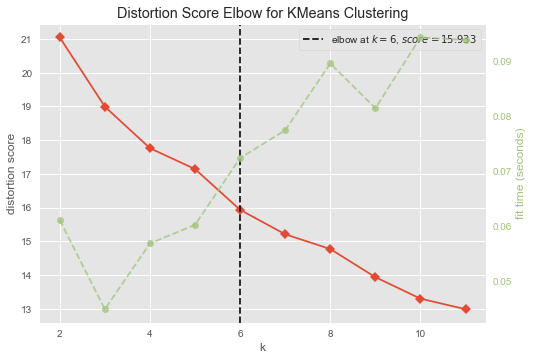

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [17]:
# using 
uni_grouped_clustering = uni_grouped.drop('University (zh)', 1)

kmeans = KMeans(random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(2, 12), locate_elbow=True)
visualizer.fit(uni_grouped_clustering)
visualizer.show()

In [18]:
# set number of clusters
kclusters = 6

# run k-means clustering
kmeans_uni = KMeans(n_clusters=kclusters).fit(uni_grouped_clustering)

# check cluster labels generated for each row in the dataframe
print(kmeans_uni.labels_)
# add clustering labels
uni_grouped.insert(0, 'Cluster Labels', kmeans_uni.labels_)

[3 1 1 3 3 1 3 3 0 3 1 1 3 1 4 1 5 5 3 1 3 0 3 3 3 3 3 3 3 3 1 1 3 3 3 1 3
 1 1 3 3 3 3 1 3 1 1 0 1 3 1 4 3 3 3 1 3 3 1 3 3 0 3 2 3 3 3 1 3 3 1 3 3 1
 1 3 3 3 3 3 0 1 5 3 3 1 1 0 3 3 3 3 3 3 5 1 3 3 1 3 3 1 1 4 3 0 1 5 1 1 3
 1 1 3 1 3 1 3 3 1 0 1 1 3 1 3 3 1 0 0 1 3 1 3 3 1 3 3 3 3 3 1 3 1 1 1 3 3
 3 1 0 1 4 4 1 1 3 1 1]


In [19]:
uni_merged = udf.copy()
uni_merged = pd.merge(uni_merged, uni_grouped, left_on="Name", right_on='University (zh)')
print(uni_merged.shape)
uni_merged.head()

(159, 238)


,Serial Number,ID,Public/Private,System,Name,Eng. Name,Postal Code,Latitude,Longitude,Address,City,County,Neighborhood,County (zh),Cluster Labels,University (zh),Accessories Store,American Restaurant,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,BBQ Joint,Bagel Shop,Bakery,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bay,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Belgian Restaurant,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boarding House,Bookstore,Botanical Garden,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Buddhist Temple,Buffet,Burger Joint,Bus Station,Bus Stop,Cable Car,Cafeteria,Café,Camera Store,Candy Store,Cantonese Restaurant,Chinese Breakfast Place,Chinese Restaurant,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,College Cafeteria,College Stadium,College Theater,Comfort Food Restaurant,Community College,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Dive Bar,Dog Run,Donburi Restaurant,Donut Shop,Dumpling Restaurant,Electronics Store,Event Service,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Field,Film Studio,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Garden,General Entertainment,German Restaurant,Gift Shop,Golf Course,Golf Driving Range,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gymnastics Gym,Hakka Restaurant,Health & Beauty Service,Hong Kong Restaurant,Hotpot Restaurant,Hunan Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jiangsu Restaurant,Juice Bar,Karaoke Bar,Korean Restaurant,Latin American Restaurant,Leather Goods Store,Library,Light Rail Station,Lounge,Malay Restaurant,Market,Massage Studio,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Moroccan Restaurant,Motorcycle Shop,Movie Theater,Multiplex,Museum,Music Venue,New American Restaurant,Night Market,Nightclub,Noodle House,Optical Shop,Other Great Outdoors,Other Nightlife,Outdoor Supply Store,Outlet Store,Paella Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Peking Duck Restaurant,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Pub,Ramen Restaurant,Record Shop,Rental Car Location,Reservoir,Resort,Restaurant,Rock Club,Sake Bar,Salad Place,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shabu-Shabu Restaurant,Shanghai Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skating Rink,Ski Area,Snack Place,Soup Place,Spa,Spanish Restaurant,Sporting Goods Shop,Stadium,Stationery Store,Steakhouse,Street Food Gathering,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tech Startup,Temple,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Toy / Game Store,Trail,Train Station,Tram Station,Used Bookstore,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Winery,Xinjiang Restaurant,Yoga Studio,Yunnan Restaurant,Zoo,Zoo Exhibit
0,1,0001,Public,一般大學,國立政治大學,National Chengchi Universerity,11605,24.98741,121.57651,"No. 64, Sec 2, Zhi Nan Rd., Wenshan District, ...",Taipei City,Taipei City,Wenshan District,臺北市,1,國立政治大學,0.000000,0.0,0.00,0.00,0.015873,0.0,0.015873,0.0,0.031746,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.015873,0.0,0.000000,0.0,0.0,0.015873,0.031746,0.015873,0.031746,0.015873,0.047619,0.0,0.0,0.0,0.0,0.031746,0.0,0.000000,0.0,0.079365,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.111111,0.0,0.0,0.015873,0.00,0.0,0.000000,0.00,0.00,0.00,0.0,0.0,0.0,0.01587

Notice that one university (和春技術學院) is dropped due to the fact that Foursquare API doesn't have enough data for the particular spot.

**Map Creation**: Now we are able to create a map with clustered universities plotted.

In [20]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=8)

# set color scheme for the clusters
x = np.arange(kclusters) # adding one more since we are containing neighborhoods with missing places 
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, county, cluster in zip(uni_merged['Latitude'], uni_merged['Longitude'], uni_merged['Eng. Name'], uni_merged['County'], uni_merged['Cluster Labels']):
    cluster = int(cluster)
    label = folium.Html(f'Cluster <b>{cluster}</b></br>{poi} @ {county}', script=True)
    label = folium.Popup(label, max_width=300, min_width=300)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

#### 3.2.2 Clustering University by Sports Facilities
We will then perform the same technique as before to see results for sports related venues.

In [21]:
print(uni_sports_venues.shape)
display(uni_sports_venues.groupby('University (zh)').count().head())

print(uni_sports_venues_2000.shape)
display(uni_sports_venues_2000.groupby('University (zh)').count().head())

(395, 8)


,University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
University (zh),,,,,,,
世新大學,8,8,8,8,8,8,8
中原大學,1,1,1,1,1,1,1
中國文化大學,1,1,1,1,1,1,1
中國科技大學,3,3,3,3,3,3,3
中國醫藥大學,2,2,2,2,2,2,2


(1352, 8)


,University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
University (zh),,,,,,,
世新大學,22,22,22,22,22,22,22
中原大學,6,6,6,6,6,6,6
中國文化大學,7,7,7,7,7,7,7
中國科技大學,13,13,13,13,13,13,13
中國醫藥大學,11,11,11,11,11,11,11


In [22]:
selected_sports_venues = ['Plaza', 'Park', 'Baseball Field', 'College Tennis Court',
'College Stadium', 'College Gym', 'Gym Pool',
'Gym / Fitness Center', 'Athletics & Sports', 'Basketball Court',
'Tennis Court', 'Gym',
'Yoga Studio', 'Martial Arts School', 'Boxing Gym',
'Skating Rink', 'Gymnastics Gym', 'Beach',
'Skate Park', 'Bike Trail',
'College Basketball Court', 'Volleyball Court', 'Bike Rental / Bike Share', 
'Recreation Center', 'Ski Area', 'Climbing Gym', 'Golf Course', 'Other Great Outdoors',
'Paintball Field', 'Trail', 'Sports Club', 'Track']

In [23]:
print('1,000 m: There are {} uniques categories.'.format(len(uni_sports_venues['Venue Category'].unique())))
print('2,000 m: There are {} uniques categories.'.format(len(uni_sports_venues_2000['Venue Category'].unique())))

1,000 m: There are 45 uniques categories.
2,000 m: There are 64 uniques categories.


In [24]:
# one hot encoding
uni_sports_onehot = pd.get_dummies(uni_sports_venues[['Venue Category']], prefix="", prefix_sep="")

uni_sports_onehot[['University (zh)', 'University (eng)']] = uni_sports_venues[['University (zh)', 'University (eng)']] 

fixed_columns = list(uni_sports_onehot.columns[-2:]) + list(uni_sports_onehot.columns[:-2])
uni_sports_onehot = uni_sports_onehot[fixed_columns]
uni_sports_onehot = uni_sports_onehot[['University (zh)'] + selected_sports_venues]

# grouping
uni_sports_grouped = uni_sports_onehot.groupby('University (zh)').mean().reset_index()
display(uni_sports_grouped.head())

# 2000m
# one hot encoding
uni_sports_onehot_2000 = pd.get_dummies(uni_sports_venues_2000[['Venue Category']], prefix="", prefix_sep="")

uni_sports_onehot_2000[['University (zh)', 'University (eng)']] = uni_sports_venues_2000[['University (zh)', 'University (eng)']] 

fixed_columns = list(uni_sports_onehot_2000.columns[-2:]) + list(uni_sports_onehot_2000.columns[:-2])
uni_sports_onehot_2000 = uni_sports_onehot_2000[fixed_columns]
uni_sports_onehot_2000 = uni_sports_onehot_2000[['University (zh)'] + selected_sports_venues]

# grouping
uni_sports_grouped_2000 = uni_sports_onehot_2000.groupby('University (zh)').mean().reset_index()
display(uni_sports_grouped_2000.head())

,University (zh),Plaza,Park,Baseball Field,College Tennis Court,College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Athletics & Sports,Basketball Court,Tennis Court,Gym,Yoga Studio,Martial Arts School,Boxing Gym,Skating Rink,Gymnastics Gym,Beach,Skate Park,Bike Trail,College Basketball Court,Volleyball Court,Bike Rental / Bike Share,Recreation Center,Ski Area,Climbing Gym,Golf Course,Other Great Outdoors,Paintball Field,Trail,Sports Club,Track
0,世新大學,0.0,0.625000,0.0,0.0,0.0,0.125,0.0,0.125,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.125,0.0,0.0,0.0,0.0,0.0
1,中原大學,0.0,0.000000,0.0,0.0,0.0,1.000,0.0,0.000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0
2,中國文化大學,0.0,0.000000,0.0,0.0,0.0,1.000,0.0,0.000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0
3,中國科技大學,0.0,0.666667,0.0,0.0,0.0,0.000,0.0,0.000,0.0,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0
4,中國醫藥大學,0.0,0.500000,0.0,0.0,0.0,0.000,0.0,0.000,0.5,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0


,University (zh),Plaza,Park,Baseball Field,College Tennis Court,College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Athletics & Sports,Basketball Court,Tennis Court,Gym,Yoga Studio,Martial Arts School,Boxing Gym,Skating Rink,Gymnastics Gym,Beach,Skate Park,Bike Trail,College Basketball Court,Volleyball Court,Bike Rental / Bike Share,Recreation Center,Ski Area,Climbing Gym,Golf Course,Other Great Outdoors,Paintball Field,Trail,Sports Club,Track
0,世新大學,0.0,0.454545,0.0,0.0,0.0,0.045455,0.0,0.045455,0.000000,0.0,0.0,0.181818,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.045455,0.0,0.0,0.0,0.045455,0.0,0.0,0.181818,0.0,0.0,0.000000,0.0,0.0
1,中原大學,0.0,0.500000,0.0,0.0,0.0,0.166667,0.0,0.000000,0.000000,0.0,0.0,0.333333,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
2,中國文化大學,0.0,0.857143,0.0,0.0,0.0,0.142857,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
3,中國科技大學,0.0,0.692308,0.0,0.0,0.0,0.076923,0.0,0.000000,0.000000,0.0,0.0,0.076923,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.076923,0.0,0.0,0.076923,0.0,0.0
4,中國醫藥大學,0.0,0.454545,0.0,0.0,0.0,0.000000,0.0,0.090909,0.090909,0.0,0.0,0.272727,0.090909,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0


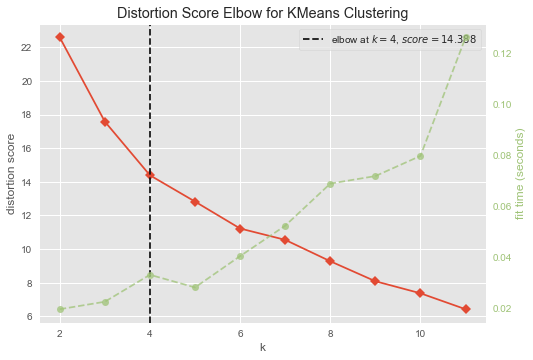

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [25]:
# using 
uni_sports_grouped_clustering = uni_sports_grouped.drop('University (zh)', 1)

kmeans = KMeans(random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(2, 12), locate_elbow=True)
visualizer.fit(uni_sports_grouped_clustering)
visualizer.show()

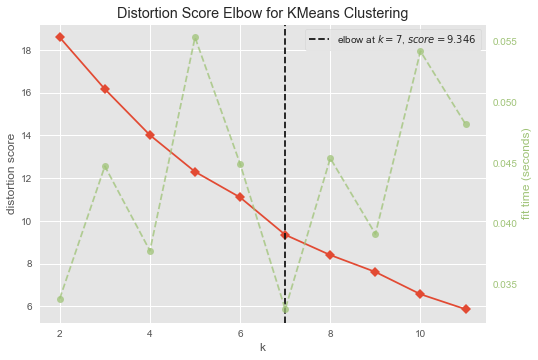

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [26]:
# using 
uni_sports_grouped_clustering_2000 = uni_sports_grouped_2000.drop('University (zh)', 1)

kmeans = KMeans(random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(2, 12), locate_elbow=True)
visualizer.fit(uni_sports_grouped_clustering_2000)
visualizer.show()

In [27]:
# set number of clusters
kclusters = 4

# run k-means clustering
kmeans_sports = KMeans(n_clusters=kclusters).fit(uni_sports_grouped_clustering)

# check cluster labels generated for each row in the dataframe
print(kmeans_sports.labels_)
# add clustering labels
uni_sports_grouped.insert(0, 'Cluster Labels', kmeans_sports.labels_)

uni_sports_merged = udf.copy()
uni_sports_merged = pd.merge(uni_sports_merged, uni_sports_grouped, left_on="Name", right_on='University (zh)')
print(uni_sports_merged.shape)
display(uni_sports_merged.head())

[3 1 1 3 2 3 2 0 2 1 3 2 0 2 3 2 2 2 3 3 1 2 2 1 2 3 0 3 2 3 2 2 2 2 2 2 2
 2 2 2 2 2 2 3 1 2 1 3 3 3 2 3 2 2 3 2 3 0 2 2 0 3 1 2 1 2 2 0 3 3 2 2 2 2
 2 1 1 1 3 0]
(80, 48)


,Serial Number,ID,Public/Private,System,Name,Eng. Name,Postal Code,Latitude,Longitude,Address,City,County,Neighborhood,County (zh),Cluster Labels,University (zh),Plaza,Park,Baseball Field,College Tennis Court,College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Athletics & Sports,Basketball Court,Tennis Court,Gym,Yoga Studio,Martial Arts School,Boxing Gym,Skating Rink,Gymnastics Gym,Beach,Skate Park,Bike Trail,College Basketball Court,Volleyball Court,Bike Rental / Bike Share,Recreation Center,Ski Area,Climbing Gym,Golf Course,Other Great Outdoors,Paintball Field,Trail,Sports Club,Track
0,1,0001,Public,一般大學,國立政治大學,National Chengchi Universerity,11605,24.98741,121.57651,"No. 64, Sec 2, Zhi Nan Rd., Wenshan District, ...",Taipei City,Taipei City,Wenshan District,臺北市,2,國立政治大學,0.25,0.250000,0.250000,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,0002,Public,一般大學,國立清華大學,National Tsing Hua University,30013,24.79635,120.99686,"No. 101, Sec 2, Guang Fu Rd., East District, H...",Hsinchu City,Hsinchu City,East District,新竹市,2,國立清華大學,0.00,0.000000,0.000000,0.000000,0.333333,0.333333,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3,0003,Public,一般大學,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,10617,25.01697,121.53369,"No. 1, Sec 4, Luo Si Fu Rd., Daan District, Ta...",Taipei City,Taipei City,Daan District,臺北市,2,國立臺灣大學,0.00,0.428571,0.047619,0.047619,0.000000,0.095238,0.000000,0.095238,0.095238,0.142857,0.047619,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4,0004,Public,一般大學,國立臺灣師範大學,National Taiwan Normal University,10610,25.02643,121.52756,"No. 162, Sec 1, He Ping E. Rd., Daan District,...",Taipei City,Taipei City,Daan District,臺北市,2,國立臺灣師範大學,0.00,0.451613,0.032258,0.000000,0.000000,0.064516,0.000000,0.129032,0.064516,0.000000,0.000000,0.032258,0.096774,0.032258,0.032258,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,5,0005,Public,一般大學,國立成功大學,National Cheng Kung University,70101,22.99632,120.21953,"No. 1, Da Syue Rd., East District, Tainan City...",Tainan City,Tainan City,East District,臺南市,2,國立成功大學,0.00,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.125000,0.000000,0.000000,0.000000,0.250000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Notice that more than one university is dropped due to the fact that Foursquare API doesn't have enough data for the particular spot.

**Map Creation**: Now we are able to create a map with clustered universities plotted.

In [28]:
# create map
map_sports_clusters = folium.Map(location=[latitude, longitude], zoom_start=7)

# set color scheme for the clusters
x = np.arange(kclusters) # adding one more since we are containing neighborhoods with missing places 
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, county, cluster in zip(uni_sports_merged['Latitude'], uni_sports_merged['Longitude'], uni_sports_merged['Eng. Name'], uni_sports_merged['County'], uni_sports_merged['Cluster Labels']):
    cluster = int(cluster)
    label = folium.Html(f'Cluster <b>{cluster}</b></br>{poi} @ {county}', script=True)
    label = folium.Popup(label, max_width=300, min_width=300)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_sports_clusters)
       
map_sports_clusters

In [29]:
# set number of clusters
kclusters = 7

# run k-means clustering
kmeans_sports_2000 = KMeans(n_clusters=kclusters).fit(uni_sports_grouped_clustering_2000)

# check cluster labels generated for each row in the dataframe
print(kmeans_sports_2000.labels_)
# add clustering labels
uni_sports_grouped_2000.insert(0, 'Cluster Labels', kmeans_sports_2000.labels_)

uni_sports_merged_2000 = udf.copy()
uni_sports_merged_2000 = pd.merge(uni_sports_merged_2000, uni_sports_grouped_2000, left_on="Name", right_on='University (zh)')
print(uni_sports_merged_2000.shape)
display(uni_sports_merged.head())

[2 2 4 4 2 1 4 4 2 1 2 2 3 4 2 2 2 4 4 2 1 2 4 2 4 3 2 2 3 2 2 2 2 2 4 2 2
 2 2 2 2 2 2 2 2 2 2 2 4 3 2 3 2 1 2 2 4 2 2 2 2 2 5 2 3 3 2 2 1 5 0 1 2 2
 1 0 6 3 3 6 1 2 2 2 2 2 2 2 2 4 2 3 3 3 4 2 4]
(97, 48)


,Serial Number,ID,Public/Private,System,Name,Eng. Name,Postal Code,Latitude,Longitude,Address,City,County,Neighborhood,County (zh),Cluster Labels,University (zh),Plaza,Park,Baseball Field,College Tennis Court,College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Athletics & Sports,Basketball Court,Tennis Court,Gym,Yoga Studio,Martial Arts School,Boxing Gym,Skating Rink,Gymnastics Gym,Beach,Skate Park,Bike Trail,College Basketball Court,Volleyball Court,Bike Rental / Bike Share,Recreation Center,Ski Area,Climbing Gym,Golf Course,Other Great Outdoors,Paintball Field,Trail,Sports Club,Track
0,1,0001,Public,一般大學,國立政治大學,National Chengchi Universerity,11605,24.98741,121.57651,"No. 64, Sec 2, Zhi Nan Rd., Wenshan District, ...",Taipei City,Taipei City,Wenshan District,臺北市,2,國立政治大學,0.25,0.250000,0.250000,0.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,0002,Public,一般大學,國立清華大學,National Tsing Hua University,30013,24.79635,120.99686,"No. 101, Sec 2, Guang Fu Rd., East District, H...",Hsinchu City,Hsinchu City,East District,新竹市,2,國立清華大學,0.00,0.000000,0.000000,0.000000,0.333333,0.333333,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3,0003,Public,一般大學,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,10617,25.01697,121.53369,"No. 1, Sec 4, Luo Si Fu Rd., Daan District, Ta...",Taipei City,Taipei City,Daan District,臺北市,2,國立臺灣大學,0.00,0.428571,0.047619,0.047619,0.000000,0.095238,0.000000,0.095238,0.095238,0.142857,0.047619,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4,0004,Public,一般大學,國立臺灣師範大學,National Taiwan Normal University,10610,25.02643,121.52756,"No. 162, Sec 1, He Ping E. Rd., Daan District,...",Taipei City,Taipei City,Daan District,臺北市,2,國立臺灣師範大學,0.00,0.451613,0.032258,0.000000,0.000000,0.064516,0.000000,0.129032,0.064516,0.000000,0.000000,0.032258,0.096774,0.032258,0.032258,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,5,0005,Public,一般大學,國立成功大學,National Cheng Kung University,70101,22.99632,120.21953,"No. 1, Da Syue Rd., East District, Tainan City...",Tainan City,Tainan City,East District,臺南市,2,國立成功大學,0.00,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.125000,0.000000,0.000000,0.000000,0.250000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
# create map
map_sports_clusters = folium.Map(location=[latitude, longitude], zoom_start=7)

# set color scheme for the clusters
x = np.arange(kclusters) # adding one more since we are containing neighborhoods with missing places 
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, county, cluster in zip(uni_sports_merged['Latitude'], uni_sports_merged['Longitude'], uni_sports_merged['Eng. Name'], uni_sports_merged['County'], uni_sports_merged['Cluster Labels']):
    cluster = int(cluster)
    label = folium.Html(f'Cluster <b>{cluster}</b></br>{poi} @ {county}', script=True)
    label = folium.Popup(label, max_width=300, min_width=300)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_sports_clusters)
       
map_sports_clusters

#### 3.2.3 Clustering University by Gym Facilities
We will then perform the same technique as before to see results for gym related business.

In [31]:
print(uni_gym_venues.shape)
display(uni_gym_venues.groupby('University (zh)').count().head())

print(uni_gym_venues_2000.shape)
display(uni_gym_venues_2000.groupby('University (zh)').count().head())

(136, 8)


,University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
University (zh),,,,,,,
世新大學,2,2,2,2,2,2,2
中原大學,1,1,1,1,1,1,1
中國文化大學,1,1,1,1,1,1,1
中國科技大學,1,1,1,1,1,1,1
中華學校財團法人中華科技大學,1,1,1,1,1,1,1


(487, 8)


,University (eng),University Latitude,University Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
University (zh),,,,,,,
世新大學,6,6,6,6,6,6,6
中原大學,3,3,3,3,3,3,3
中國文化大學,1,1,1,1,1,1,1
中國科技大學,2,2,2,2,2,2,2
中國醫藥大學,5,5,5,5,5,5,5


In [32]:
selected_gym_venues = ['College Stadium', 'College Gym', 'Gym Pool',
       'Gym / Fitness Center', 'Gym', 'Boxing Gym', 'Martial Arts School',
       'Athletics & Sports', 'Yoga Studio', 'Gymnastics Gym', 'Climbing Gym', 'Track']

In [33]:
print('There are {} uniques categories.'.format(len(uni_gym_venues['Venue Category'].unique())))
print('There are {} uniques categories.'.format(len(uni_gym_venues_2000['Venue Category'].unique())))

There are 16 uniques categories.
There are 21 uniques categories.


In [34]:
# one hot encoding
uni_gym_onehot = pd.get_dummies(uni_gym_venues[['Venue Category']], prefix="", prefix_sep="")

uni_gym_onehot[['University (zh)', 'University (eng)']] = uni_gym_venues[['University (zh)', 'University (eng)']] 

fixed_columns = list(uni_gym_onehot.columns[-2:]) + list(uni_gym_onehot.columns[:-2])
uni_gym_onehot = uni_gym_onehot[fixed_columns]
uni_gym_onehot = uni_gym_onehot[['University (zh)'] + selected_gym_venues]

# grouping
uni_gym_grouped = uni_gym_onehot.groupby('University (zh)').mean().reset_index()
uni_gym_grouped['Gym / Fitness Center'] = uni_gym_grouped[['Gym / Fitness Center', 'Gym']].sum(axis=1)
uni_gym_grouped.drop(columns=['Gym'], inplace=True)

display(uni_gym_grouped.head())

# 2000m
# one hot encoding
uni_gym_onehot_2000 = pd.get_dummies(uni_gym_venues_2000[['Venue Category']], prefix="", prefix_sep="")

uni_gym_onehot_2000[['University (zh)', 'University (eng)']] = uni_gym_venues_2000[['University (zh)', 'University (eng)']] 

fixed_columns = list(uni_gym_onehot_2000.columns[-2:]) + list(uni_gym_onehot_2000.columns[:-2])
uni_gym_onehot_2000 = uni_gym_onehot_2000[fixed_columns]
uni_gym_onehot_2000 = uni_gym_onehot_2000[['University (zh)'] + selected_gym_venues]

# grouping
uni_gym_grouped_2000 = uni_gym_onehot_2000.groupby('University (zh)').mean().reset_index()
uni_gym_grouped_2000['Gym / Fitness Center'] = uni_gym_grouped_2000[['Gym / Fitness Center', 'Gym']].sum(axis=1)
uni_gym_grouped_2000.drop(columns=['Gym'], inplace=True)
display(uni_gym_grouped_2000.head())

,University (zh),College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Boxing Gym,Martial Arts School,Athletics & Sports,Yoga Studio,Gymnastics Gym,Climbing Gym,Track
0,世新大學,0.0,0.5,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,中原大學,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,中國文化大學,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,中國科技大學,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,中華學校財團法人中華科技大學,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,University (zh),College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Boxing Gym,Martial Arts School,Athletics & Sports,Yoga Studio,Gymnastics Gym,Climbing Gym,Track
0,世新大學,0.0,0.166667,0.0,0.833333,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,中原大學,0.0,0.333333,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,中國文化大學,0.0,1.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,中國科技大學,0.0,0.500000,0.0,0.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,中國醫藥大學,0.0,0.000000,0.0,0.800000,0.0,0.0,0.0,0.2,0.0,0.0,0.0


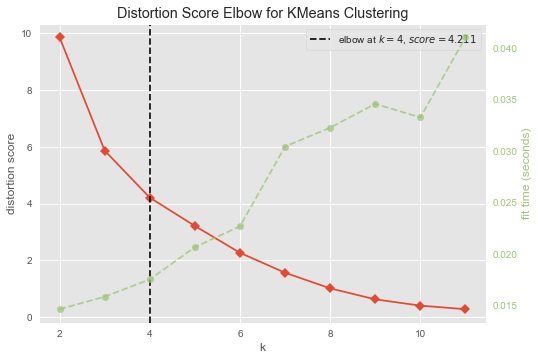

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [35]:
# using 
uni_gym_grouped_clustering = uni_gym_grouped.drop('University (zh)', 1)

kmeans = KMeans(random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(2, 12), locate_elbow=True)
visualizer.fit(uni_gym_grouped_clustering)
visualizer.show()

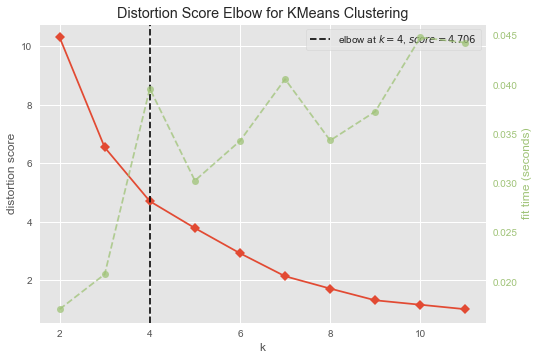

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [36]:
# using 
uni_gym_grouped_clustering_2000 = uni_gym_grouped_2000.drop('University (zh)', 1)

kmeans = KMeans(random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(2, 12), locate_elbow=True)
visualizer.fit(uni_gym_grouped_clustering_2000)
visualizer.show()

In [37]:
# set number of clusters
kclusters = 4

# run k-means clustering
kmeans_gym = KMeans(n_clusters=kclusters).fit(uni_gym_grouped_clustering)

# check cluster labels generated for each row in the dataframe
print(kmeans_gym.labels_)
# add clustering labels
uni_gym_grouped.insert(0, 'Cluster Labels', kmeans_gym.labels_)

uni_gym_merged = udf.copy()
uni_gym_merged = pd.merge(uni_gym_merged, uni_gym_grouped, left_on="Name", right_on='University (zh)')
print(uni_gym_merged.shape)
uni_gym_merged.head()

[1 0 0 2 2 2 0 2 2 3 3 0 2 0 3 2 2 1 1 2 2 1 2 2 1 1 2 1 0 1 0 2 2 3 1 2 2
 2 2 3 2 1 0 2 2 1 2 3 0 1 0 0 0 2]
(54, 27)


,Serial Number,ID,Public/Private,System,Name,Eng. Name,Postal Code,Latitude,Longitude,Address,City,County,Neighborhood,County (zh),Cluster Labels,University (zh),College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Boxing Gym,Martial Arts School,Athletics & Sports,Yoga Studio,Gymnastics Gym,Climbing Gym,Track
0,2,0002,Public,一般大學,國立清華大學,National Tsing Hua University,30013,24.79635,120.99686,"No. 101, Sec 2, Guang Fu Rd., East District, H...",Hsinchu City,Hsinchu City,East District,新竹市,3,國立清華大學,0.333333,0.333333,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,3,0003,Public,一般大學,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,10617,25.01697,121.53369,"No. 1, Sec 4, Luo Si Fu Rd., Daan District, Ta...",Taipei City,Taipei City,Daan District,臺北市,1,國立臺灣大學,0.000000,0.500000,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,4,0004,Public,一般大學,國立臺灣師範大學,National Taiwan Normal University,10610,25.02643,121.52756,"No. 162, Sec 1, He Ping E. Rd., Daan District,...",Taipei City,Taipei City,Daan District,臺北市,1,國立臺灣師範大學,0.000000,0.153846,0.000000,0.384615,0.076923,0.076923,0.076923,0.230769,0.0,0.0,0.0
3,5,0005,Public,一般大學,國立成功大學,National Cheng Kung University,70101,22.99632,120.21953,"No. 1, Da Syue Rd., East District, Tainan City...",Tainan City,Tainan City,East District,臺南市,2,國立成功大學,0.000000,0.000000,0.000000,0.750000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
4,7,0007,Public,一般大學,國立交通大學,National Chiao Tung University,30010,24.78914,120.99949,"No. 1001, Da Xue Rd., East District, Hsinchu C...",Hsinchu City,Hsinchu City,East District,新竹市,3,國立交通大學,0.333333,0.333333,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0


Notice that more than one university is dropped due to the fact that Foursquare API doesn't have enough data for the particular spot.

**Map Creation**: Now we are able to create a map with clustered universities plotted.

In [38]:
# create map
map_gym_clusters = folium.Map(location=[latitude, longitude], zoom_start=7)

# set color scheme for the clusters
x = np.arange(kclusters) # adding one more since we are containing neighborhoods with missing places 
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, county, cluster in zip(uni_gym_merged['Latitude'], uni_gym_merged['Longitude'], uni_gym_merged['Eng. Name'], uni_gym_merged['County'], uni_gym_merged['Cluster Labels']):
    cluster = int(cluster)
    label = folium.Html(f'Cluster <b>{cluster}</b></br>{poi} @ {county}', script=True)
    label = folium.Popup(label, max_width=300, min_width=300)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_gym_clusters)
       
map_gym_clusters

In [39]:
# set number of clusters
kclusters = 4

# run k-means clustering
kmeans_gym_2000 = KMeans(n_clusters=kclusters).fit(uni_gym_grouped_clustering_2000)

# check cluster labels generated for each row in the dataframe
print(kmeans_gym_2000.labels_)
# add clustering labels
uni_gym_grouped_2000.insert(0, 'Cluster Labels', kmeans_gym_2000.labels_)

uni_gym_merged_2000 = udf.copy()
uni_gym_merged_2000 = pd.merge(uni_gym_merged_2000, uni_gym_grouped_2000, left_on="Name", right_on='University (zh)')
print(uni_gym_merged_2000.shape)
uni_gym_merged_2000.head()

[1 0 2 0 1 1 1 1 0 0 2 1 1 3 3 0 3 1 0 1 1 2 3 1 1 1 0 0 0 1 0 1 1 0 0 1 0
 1 0 2 0 0 1 1 1 1 3 0 1 1 1 1 0 2 1 1 3 1 0 0 2 2 1 1 1 0 0 1 1 0 0 2 2 2
 1]
(75, 27)


,Serial Number,ID,Public/Private,System,Name,Eng. Name,Postal Code,Latitude,Longitude,Address,City,County,Neighborhood,County (zh),Cluster Labels,University (zh),College Stadium,College Gym,Gym Pool,Gym / Fitness Center,Boxing Gym,Martial Arts School,Athletics & Sports,Yoga Studio,Gymnastics Gym,Climbing Gym,Track
0,1,0001,Public,一般大學,國立政治大學,National Chengchi Universerity,11605,24.98741,121.57651,"No. 64, Sec 2, Zhi Nan Rd., Wenshan District, ...",Taipei City,Taipei City,Wenshan District,臺北市,1,國立政治大學,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,2,0002,Public,一般大學,國立清華大學,National Tsing Hua University,30013,24.79635,120.99686,"No. 101, Sec 2, Guang Fu Rd., East District, H...",Hsinchu City,Hsinchu City,East District,新竹市,3,國立清華大學,0.333333,0.333333,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
2,3,0003,Public,一般大學,國立臺灣大學,NATIONAL TAIWAN UNIVERSITY,10617,25.01697,121.53369,"No. 1, Sec 4, Luo Si Fu Rd., Daan District, Ta...",Taipei City,Taipei City,Daan District,臺北市,0,國立臺灣大學,0.000000,0.148148,0.037037,0.481481,0.037037,0.037037,0.074074,0.185185,0.0,0.0,0.0
3,4,0004,Public,一般大學,國立臺灣師範大學,National Taiwan Normal University,10610,25.02643,121.52756,"No. 162, Sec 1, He Ping E. Rd., Daan District,...",Taipei City,Taipei City,Daan District,臺北市,0,國立臺灣師範大學,0.000000,0.156250,0.031250,0.593750,0.031250,0.031250,0.031250,0.125000,0.0,0.0,0.0
4,5,0005,Public,一般大學,國立成功大學,National Cheng Kung University,70101,22.99632,120.21953,"No. 1, Da Syue Rd., East District, Tainan City...",Tainan City,Tainan City,East District,臺南市,1,國立成功大學,0.000000,0.000000,0.000000,0.833333,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0


In [40]:
# create map
map_gym_clusters_2000 = folium.Map(location=[latitude, longitude], zoom_start=7)

# set color scheme for the clusters
x = np.arange(kclusters) # adding one more since we are containing neighborhoods with missing places 
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, county, cluster in zip(uni_gym_merged_2000['Latitude'], uni_gym_merged_2000['Longitude'], uni_gym_merged_2000['Eng. Name'], uni_gym_merged_2000['County'], uni_gym_merged['Cluster Labels']):
    cluster = int(cluster)
    label = folium.Html(f'Cluster <b>{cluster}</b></br>{poi} @ {county}', script=True)
    label = folium.Popup(label, max_width=300, min_width=300)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_gym_clusters_2000)
       
map_gym_clusters_2000

### 3.3 Data Analysis

In this section, we'd analyze the clusters obtained from the above steps. We will look into the following clustering results:

+ uni_merged (6)
+ uni_sports_merged (4)
+ uni_sports_merged_2000 (7)
+ uni_gym_merged (4)
+ uni_gym_merged_2000 (4)

Before I get started, I'll define some useful functions to get going.

In [121]:
from IPython.display import display, HTML
from sklearn.tree import _tree, DecisionTreeClassifier

def pretty_print(df):
    return display( HTML( df.to_html().replace("\\n","<br>") ) )

def get_class_rules(tree: DecisionTreeClassifier, feature_names: list):
  inner_tree: _tree.Tree = tree.tree_
  classes = tree.classes_
  class_rules_dict = dict()

  def tree_dfs(node_id=0, current_rule=[]):
    # feature[i] holds the feature to split on, for the internal node i.
    split_feature = inner_tree.feature[node_id]
    if split_feature != _tree.TREE_UNDEFINED: # internal node
      name = feature_names[split_feature]
      threshold = inner_tree.threshold[node_id]
      # left child
      left_rule = current_rule + ["({} <= {})".format(name, threshold)]
      tree_dfs(inner_tree.children_left[node_id], left_rule)
      # right child
      right_rule = current_rule + ["({} > {})".format(name, threshold)]
      tree_dfs(inner_tree.children_right[node_id], right_rule)
    else: # leaf
      dist = inner_tree.value[node_id][0]
      dist = dist/dist.sum()
      max_idx = dist.argmax()
      if len(current_rule) == 0:
        rule_string = "ALL"
      else:
        rule_string = " and ".join(current_rule)
      # register new rule to dictionary
      selected_class = classes[max_idx]
      class_probability = dist[max_idx]
      class_rules = class_rules_dict.get(selected_class, [])
      class_rules.append((rule_string, class_probability))
      class_rules_dict[selected_class] = class_rules
    
  tree_dfs() # start from root, node_id = 0
  return class_rules_dict

def cluster_report(data: pd.DataFrame, clusters, max_depth=10, min_samples_leaf=50, pruning_level=0.01):
    # Create Model
    tree = DecisionTreeClassifier(criterion="entropy", max_depth=max_depth, random_state=0) # min_samples_leaf=min_samples_leaf, ccp_alpha=pruning_level
    # criterion="entropy", max_depth = 4
    tree.fit(data, clusters)
    
    # Generate Report
    feature_names = data.columns
    class_rule_dict = get_class_rules(tree, feature_names)

    report_class_list = []
    for class_name in class_rule_dict.keys():
        rule_list = class_rule_dict[class_name]
        combined_string = ""
        for rule in rule_list:
            combined_string += "[{}] {}\n\n".format(rule[1], rule[0])
        report_class_list.append((class_name, combined_string))
        
    cluster_instance_df = pd.Series(clusters).value_counts().reset_index()
    cluster_instance_df.columns = ['class_name', 'instance_count']
    report_df = pd.DataFrame(report_class_list, columns=['class_name', 'rule_list'])
    report_df = pd.merge(cluster_instance_df, report_df, on='class_name', how='left')
    pretty_print(report_df.sort_values(by='class_name')[['class_name', 'instance_count', 'rule_list']])
    return report_df.sort_values(by='class_name')[['class_name', 'instance_count', 'rule_list']]

def return_most_common_venues(row, num_top_venues, cluster=0):
    row_categories = (row / sum(row)).to_frame().reset_index()
    row_categories.columns = ['Venues', 'Percentage']
    row_categories_sorted = row_categories.sort_values('Percentage', ascending=False)

    top_ven = row_categories_sorted.iloc[:num_top_venues].copy()

    others = pd.DataFrame(data = {
        'Venues' : ['Others'],
        'Percentage' : [row_categories_sorted['Percentage'][num_top_venues:].sum()]
    })
    
    top_ven = pd.concat([top_ven, others])

    labels = top_ven['Venues']
    sizes = top_ven['Percentage']

    fig, ax = plt.subplots()
    label_num = len(labels)
    color=mgt2001.color_palette(label_num, 'Spectral')
    ax.pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90, colors=color)
    ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.title(f"Cluster {cluster}'s Relative Frequency Distribution")
    plt.show()
    
    return row_categories_sorted.index.values[0:num_top_venues]


def analysis_report(onehot, kmeans, merged, selected_cats, num_top_venues=10, kclusters=4, max_depth=5):
    """
    return cr, cat_sorted, map_cluster (again)
    """
    cat = onehot.groupby('University (zh)').sum().reset_index()
    cat['Cluster Labels'] = kmeans.labels_
    
    # cat.groupby('Cluster Labels').sum().iloc[0, :] / sum(cat.groupby('Cluster Labels').sum().iloc[0, :])

    # still hasn't been changed
    num_top_venues = num_top_venues
    kclusters = kclusters

    indicators = ['st', 'nd', 'rd']

    # create columns according to number of top venues
    columns = ['Cluster Labels']
    for ind in np.arange(num_top_venues):
        try:
            columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
        except:
            columns.append('{}th Most Common Venue'.format(ind+1))

    # create a new dataframe
    cat_sorted = pd.DataFrame(columns=columns)
    cat_sorted['Cluster Labels'] = np.arange(0, kclusters)
    for ind in np.arange(kclusters):
        cat_sorted.iloc[ind, 1:] = return_most_common_venues(cat.groupby('Cluster Labels').sum().iloc[ind, :], num_top_venues, cluster=ind)

    cr = cluster_report(merged[selected_cats], merged['Cluster Labels'], min_samples_leaf=1, pruning_level=0.5, max_depth=max_depth)
    
    # update map
    map_clusters = folium.Map(location=[latitude, longitude], zoom_start=8)

    # set color scheme for the clusters
    x = np.arange(kclusters)
    ys = [i + x + (i*x)**2 for i in range(kclusters)]
    colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
    rainbow = [colors.rgb2hex(i) for i in colors_array]
    # add markers to the map
    markers_colors = []
    for lat, lon, poi, county, cluster in zip(merged['Latitude'], merged['Longitude'], merged['Eng. Name'], merged['County'], merged['Cluster Labels']):
        cluster = int(cluster)
        label = folium.Html(f'Cluster <b>{cluster}</b>: {cr.iloc[cluster, 2]}</br>{poi} @ {county}', script=True)
        label = folium.Popup(label, max_width=300, min_width=300)
        folium.CircleMarker(
            [lat, lon],
            radius=3,
            popup=label,
            color=rainbow[cluster-1],
            fill=True,
            fill_color=rainbow[cluster-1],
            fill_opacity=0.7).add_to(map_clusters)

    
    return cr, cat_sorted, map_clusters

#### 3.3.1 Clustering University by Convenience

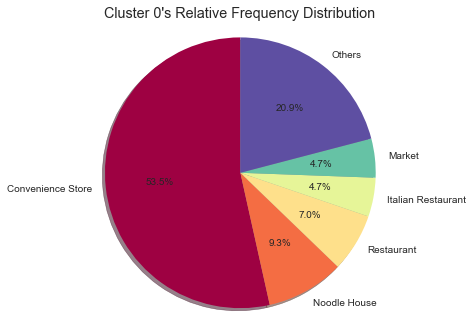

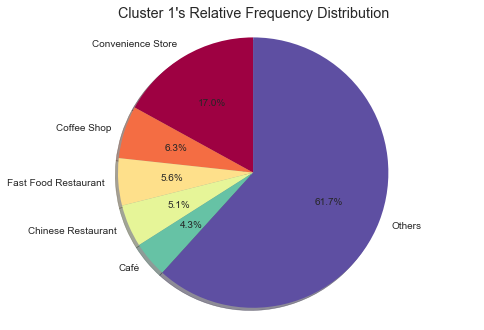

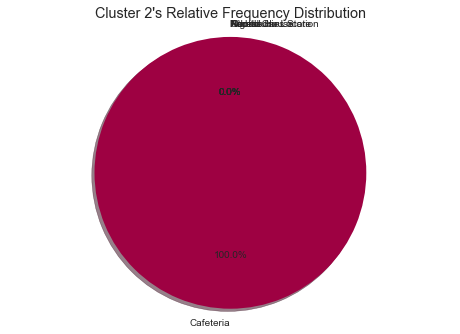

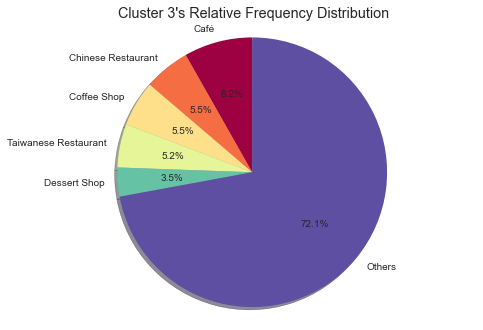

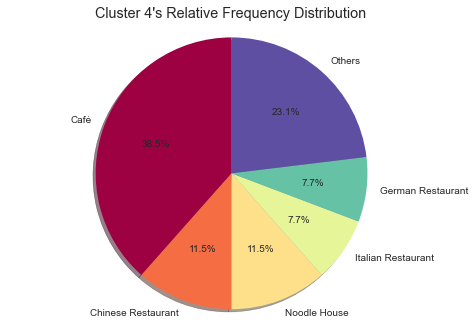

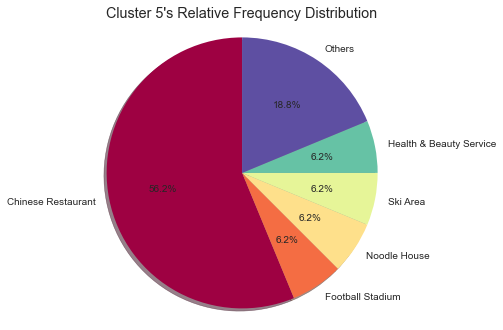

,class_name,instance_count,rule_list
2,0,11,[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store > 0.3205128312110901) and (Convenience Store <= 0.3818181902170181) and (Noodle House > 0.1666666716337204)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store > 0.3205128312110901) and (Convenience Store > 0.3818181902170181)
1,1,56,[1.0] (Convenience Store <= 0.09568439424037933) and (Chinese Restaurant <= 0.32500000298023224) and (Café <= 0.2916666716337204) and (Cafeteria <= 0.5) and (Bakery > 0.5833333358168602)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store <= 0.3205128312110901) and (Convenience Store <= 0.115079365670681) and (Fast Food Restaurant > 0.012500000186264515) and (Dumpling Restaurant <= 0.03219512104988098)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store <= 0.3205128312110901) and (Convenience Store > 0.115079365670681)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store > 0.3205128312110901) and (Convenience Store <= 0.3818181902170181) and (Noodle House <= 0.1666666716337204)
5,2,1,[1.0] (Convenience Store <= 0.09568439424037933) and (Chinese Restaurant <= 0.32500000298023224) and (Café <= 0.2916666716337204) and (Cafeteria > 0.5)
0,3,81,[1.0] (Convenience Store <= 0.09568439424037933) and (Chinese Restaurant <= 0.32500000298023224) and (Café <= 0.2916666716337204) and (Cafeteria <= 0.5) and (Bakery <= 0.5833333358168602)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store <= 0.3205128312110901) and (Convenience Store <= 0.115079365670681) and (Fast Food Restaurant <= 0.012500000186264515) and (Art Museum <= 0.10555555671453476)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store <= 0.3205128312110901) and (Convenience Store <= 0.115079365670681) and (Fast Food Restaurant > 0.012500000186264515) and (Dumpling Restaurant > 0.03219512104988098)
4,4,5,[1.0] (Convenience Store <= 0.09568439424037933) and (Chinese Restaurant <= 0.32500000298023224) and (Café > 0.2916666716337204)[1.0] (Convenience Store > 0.09568439424037933) and (Convenience Store <= 0.3205128312110901) and (Convenience Store <= 0.115079365670681) and (Fast Food Restaurant <= 0.012500000186264515) and (Art Museum > 0.10555555671453476)
3,5,5,[1.0] (Convenience Store <= 0.09568439424037933) and (Chinese Restaurant > 0.32500000298023224)


In [122]:
uni_cr, uni_cat_sorted, uni_map_clusters = analysis_report(uni_onehot, kmeans_uni, uni_merged, selected_cats, kclusters=6, num_top_venues=5)

In [123]:
uni_map_clusters

#### 3.3.2 Clustering University by Sports Facilities

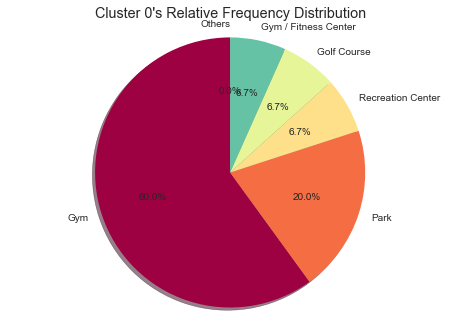

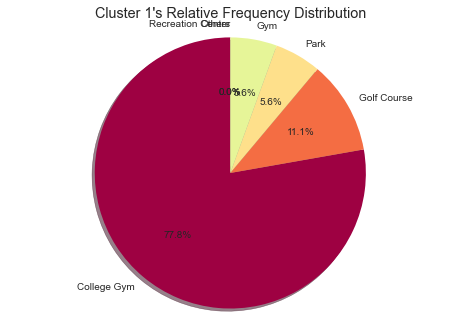

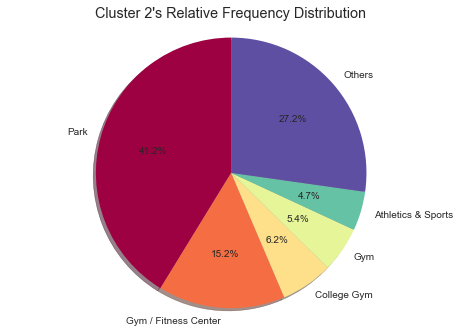

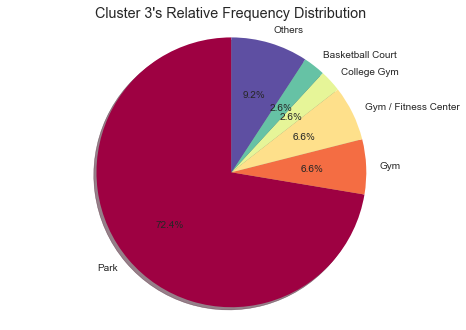

,class_name,instance_count,rule_list
3,0,7,[1.0] (Park <= 0.5357142984867096) and (College Gym <= 0.4166666716337204) and (Gym > 0.3392857164144516)
2,1,12,[1.0] (Park <= 0.5357142984867096) and (College Gym > 0.4166666716337204)
0,2,40,[1.0] (Park <= 0.5357142984867096) and (College Gym <= 0.4166666716337204) and (Gym <= 0.3392857164144516)
1,3,21,[1.0] (Park > 0.5357142984867096)


In [124]:
uni_sports_cr, uni_sports_cat_sorted, uni_sports_map_clusters = analysis_report(uni_sports_onehot, kmeans_sports, uni_sports_merged, selected_sports_venues, 5, 4)

In [125]:
uni_sports_map_clusters